# ETL

### Importing Libraries

In [33]:
import zipfile
import pandas as pd
import missingno as msno 
import warnings
warnings.filterwarnings("ignore")
import pymongo
from geopy.geocoders import Nominatim
import datetime
from bs4 import BeautifulSoup
from webdriver_manager.chrome import ChromeDriverManager
import pandas as pd
import ssl
import certifi
from urllib import request as req
import requests

#ssl._create_default_https_context = ssl._create_unverified_context

from pymongo import MongoClient 

In [34]:
#!pip install geopy

## DATA EXTRACTING

In [35]:
def data_scraper(url,html_part='div',id='widget_362_0_197'):
    response = requests.get(url)
    soup = BeautifulSoup(response.text, 'html.parser')
    quotes = soup.find_all(html_part, id=id)  
    lis=quotes[0].find_all('li')
    Download_url=[]
    for li in lis:
        link=li.find("a")
        href=link["href"]
        Download_url.append("https://www.atlantapd.org"+href)
        for i in range(len(Download_url)):
            try:
                local_file = f'resources/cobra{i}.zip'
                req.urlretrieve(Download_url[i], local_file)
            except:
                print("something is wrong :( ")
                
    return Download_url

#Download_url=data_scraper('https://www.atlantapd.org/i-want-to/crime-data-downloads')

## Reading CSV files

In [40]:
dfs=[pd.read_csv(f'resources/cobra{i}.zip',compression='zip') for i in range(5)]
dfs[0].head(2)

,offense_id,rpt_date,occur_date,occur_day,occur_day_num,occur_time,poss_date,poss_time,beat,zone,location,ibr_code,UC2_Literal,neighborhood,npu,lat,long
0,203140048,2/21/2022,11/9/2020,Monday,2.0,00:32,11/9/2020,01:49,409,4,"2111 CAMPBELLTON RD SW\nATLANTA, GA 30311\nUNI...",13A,AGG ASSAULT,Adams Park,R,33.706526,-84.458000
1,203421469,2/27/2022,12/7/2020,Monday,2.0,19:43,12/7/2020,20:26,405,4,"150 PEYTON PL SW\nATLANTA, GA 30311\nUNITED ST...",23B,LARCENY-NON VEHICLE,Harland Terrace,I,33.750613,-84.473202


## DATA TRANSFORMING

### Keeping specific columns and Droppping unnecessary columns

In [5]:
dfs[0]=dfs[0][['offense_id', 'rpt_date', 'occur_date','occur_time', 'poss_date', 'poss_time', 'beat', 
               'location', 'UC2_Literal', 'neighborhood', 'npu', 'lat', 'long']]

dfs[1]=dfs[1][['offense_id', 'rpt_date', 'occur_date','occur_time', 'poss_date', 'poss_time', 'beat', 
               'location','UC2_Literal', 'neighborhood', 'npu', 'lat', 'long']]

dfs[2]=dfs[2][['offense_id', 'rpt_date', 'occur_date', 'occur_time', 'poss_date','poss_time', 'beat', 
                'location', 'UC2_Literal', 'neighborhood', 'npu', 'long', 'lat']]

dfs[3]=dfs[3][['offense_id', 'rpt_date', 'occur_date', 'occur_time', 'poss_date','poss_time', 'beat', 
                'location', 'UC2_Literal','neighborhood', 'npu', 'lat', 'long']]

dfs[4]=dfs[4][['Report Number', 'Report Date', 'Occur Date', 'Occur Time','Possible Date', 'Possible Time', 'Beat', 
               'Location','UCR Literal', 'Neighborhood', 'NPU', 'Latitude','Longitude']]

### Columns reordering and making the same name

In [6]:
dfs[0].columns=['offense_id', 'rpt_date', 'occur_date','occur_time', 'poss_date', 'poss_time', 'beat', 
               'location', 'UC2_Literal', 'neighborhood', 'npu', 'lat', 'long']
dfs[1].columns=['offense_id', 'rpt_date', 'occur_date','occur_time', 'poss_date', 'poss_time', 'beat', 
               'location', 'UC2_Literal', 'neighborhood', 'npu', 'lat', 'long']
dfs[2].columns=['offense_id', 'rpt_date', 'occur_date','occur_time', 'poss_date', 'poss_time', 'beat', 
               'location', 'UC2_Literal', 'neighborhood', 'npu', 'long', 'lat']
dfs[2]=dfs[2].reindex(['offense_id', 'rpt_date', 'occur_date','occur_time', 'poss_date', 'poss_time', 'beat', 
               'location', 'UC2_Literal', 'neighborhood', 'npu', 'lat', 'long'], axis=1)

dfs[3].columns=['offense_id', 'rpt_date', 'occur_date','occur_time', 'poss_date', 'poss_time', 'beat', 
               'location', 'UC2_Literal', 'neighborhood', 'npu',  'lat', 'long']
dfs[4].columns=['offense_id', 'rpt_date', 'occur_date','occur_time', 'poss_date', 'poss_time', 'beat', 
               'location', 'UC2_Literal', 'neighborhood', 'npu',  'lat', 'long']

### dropping the issued values

In [7]:
values=["0220-11-01","1010-10-30","220-11-01","0202-12-02"]
years=[1916, 1920, 1970, 1973, 1976, 1979, 1980, 1991, 1993, 2000, 2001,
           2003, 2004, 2005, 2006, 2007, 2008]
dfs[2]= dfs[2][dfs[2].occur_date.isin(values) == False]
dfs[2]= dfs[2][dfs[2].poss_date.isin(values) == False]
dfs[4]= dfs[4][dfs[4].occur_time!= "T"]


### Changing the date column to datetime format

In [8]:

for i in range(5):
    dfs[i]["occur_date"]=pd.to_datetime(dfs[i]["occur_date"])
    dfs[i]["occur_year"]=dfs[i]["occur_date"].dt.year
    dfs[i]["occur_month"]=dfs[i]["occur_date"].dt.month_name()


In [9]:
for i in range(5):
    dfs[i]["poss_date"]=pd.to_datetime(dfs[i]["poss_date"])


### Concanating dataframes

In [10]:
df=pd.concat([dfs[0], dfs[1],dfs[2],dfs[3],dfs[4]])

<AxesSubplot:>

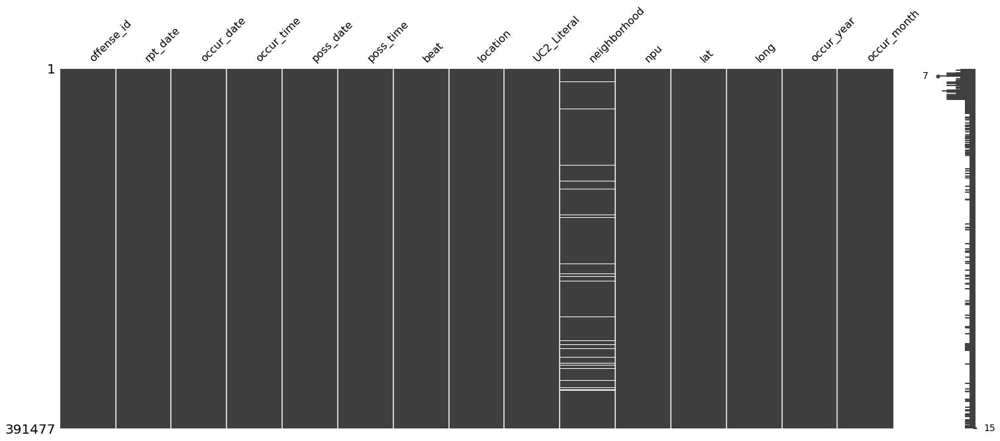

In [11]:
msno.matrix(df)

### Dropping null values and Duplicate values

In [12]:
#checking duplicate row 
df.duplicated().sum()

177

In [13]:
#drop duplicate value
df.drop_duplicates(inplace=True)

In [14]:
#checking duplicate row 
df.duplicated(subset=['offense_id']).sum()

331

In [15]:
#drop duplicate value
df.drop_duplicates(inplace=True,subset=['offense_id'])

In [16]:
#drop null value
df.dropna(inplace=True)

In [17]:
#Convert all occur_time to same format

#Convert to string
df['occur_time'] = df['occur_time'].astype('str')
#Take out minutes
df['occur_time_right'] = df['occur_time'].str[-2:]
#Take out the hour and possibly the ":"
df['occur_time_left'] = df['occur_time'].str[:-2]
#Remove ":"
df['occur_time_left'] = df['occur_time_left'].str.replace(":", "")
#Add leading zeros
df['occur_time_left'] = df['occur_time_left'].apply(lambda x: x.zfill(2))
#Combine hours + ":" + minutes
df['occur_time'] = df['occur_time_left']+":"+df['occur_time_right']
#Drop columns
df = df.drop(columns = ['occur_time_left', 'occur_time_right'])

#Convert all poss_time to same format

#Split on "." and take the left half to convert float to integer
df['poss_time'] = df['poss_time'].astype('str').str.split(".", expand=True)[0]
df['poss_time_right'] = df['poss_time'].str[-2:]
df['poss_time_left'] = df['poss_time'].str[:-2]
df['poss_time_left'] = df['poss_time_left'].str.replace(":", "")
df['poss_time_left'] = df['poss_time_left'].apply(lambda x: x.zfill(2))
df['poss_time'] = df['poss_time_left']+":"+df['poss_time_right']
df = df.drop(columns = ['poss_time_left', 'poss_time_right'])

### Dropping the issued values

In [19]:
years=[i for i in range(2009)]
df=df[df.occur_year.isin(years) == False]


### Data aggregation

In [20]:
map_df=df.groupby(["npu","occur_year"]).count()['offense_id'].reset_index()

map_df=map_df.pivot_table(values='offense_id',index=['npu'],columns=['occur_year'])


In [21]:
map_df.columns=map_df.columns.astype("str")

In [22]:
year_map_dict=map_df.to_dict(orient = 'records')
j=list("ABCDEFGHIJKLMNOPQRSTVWXYZ")
z=0
for i in range(len(year_map_dict)):
    
    year_map_dict[i]['id']=j[z]
    z+=1
   

In [23]:
year_map_cat=df.groupby(["npu","UC2_Literal","occur_year"]).count()['offense_id'].reset_index()
year_map_cat.occur_year=year_map_cat.occur_year.astype("str")
year_cat_dict=year_map_cat.to_dict(orient = 'records')

In [24]:
df.reset_index(inplace=True)
data_dict = df.to_dict(orient = 'records')

## DATA LOADING

In [25]:
client = MongoClient() 
db=client.crime_db

In [26]:
#for original data:df
db.crime_info.drop()
result = db.crime_info.insert_many(data_dict)

In [27]:
#for year_map_df
db.npu.drop()
crime = db.npu 
result2 = db.npu.insert_many(year_map_dict)

In [28]:
#for cat_map_df
db.cat.drop()
result3 = db.cat.insert_many(year_cat_dict)

## Testing

In [30]:
listings = db.npu.find()

for listing in listings:
    print(listing)

{'_id': ObjectId('624d85f3857dd02546cd30a3'), '2009.0': 282, '2010.0': 266, '2011.0': 241, '2012.0': 275, '2013.0': 335, '2014.0': 248, '2015.0': 237, '2016.0': 264, '2017.0': 186, '2018.0': 202, '2019.0': 178, '2020.0': 235, '2021.0': 136, '2022.0': 30, 'id': 'A'}
{'_id': ObjectId('624d85f3857dd02546cd30a4'), '2009.0': 2904, '2010.0': 2935, '2011.0': 2330, '2012.0': 2537, '2013.0': 2496, '2014.0': 2364, '2015.0': 2466, '2016.0': 2611, '2017.0': 2702, '2018.0': 2805, '2019.0': 2670, '2020.0': 2502, '2021.0': 2151, '2022.0': 446, 'id': 'B'}
{'_id': ObjectId('624d85f3857dd02546cd30a5'), '2009.0': 386, '2010.0': 326, '2011.0': 361, '2012.0': 389, '2013.0': 342, '2014.0': 310, '2015.0': 302, '2016.0': 349, '2017.0': 274, '2018.0': 322, '2019.0': 327, '2020.0': 273, '2021.0': 273, '2022.0': 56, 'id': 'C'}
{'_id': ObjectId('624d85f3857dd02546cd30a6'), '2009.0': 1127, '2010.0': 959, '2011.0': 963, '2012.0': 1025, '2013.0': 900, '2014.0': 996, '2015.0': 1145, '2016.0': 1265, '2017.0': 1278, '2

In [31]:
listings = db.cat.find()

for listing in listings:
    print(listing)

{'_id': ObjectId('624d85f5857dd02546cd30bc'), 'npu': 'A', 'UC2_Literal': 'AGG ASSAULT', 'occur_year': '2009.0', 'offense_id': 4}
{'_id': ObjectId('624d85f5857dd02546cd30bd'), 'npu': 'A', 'UC2_Literal': 'AGG ASSAULT', 'occur_year': '2010.0', 'offense_id': 4}
{'_id': ObjectId('624d85f5857dd02546cd30be'), 'npu': 'A', 'UC2_Literal': 'AGG ASSAULT', 'occur_year': '2011.0', 'offense_id': 6}
{'_id': ObjectId('624d85f5857dd02546cd30bf'), 'npu': 'A', 'UC2_Literal': 'AGG ASSAULT', 'occur_year': '2012.0', 'offense_id': 5}
{'_id': ObjectId('624d85f5857dd02546cd30c0'), 'npu': 'A', 'UC2_Literal': 'AGG ASSAULT', 'occur_year': '2013.0', 'offense_id': 6}
{'_id': ObjectId('624d85f5857dd02546cd30c1'), 'npu': 'A', 'UC2_Literal': 'AGG ASSAULT', 'occur_year': '2014.0', 'offense_id': 3}
{'_id': ObjectId('624d85f5857dd02546cd30c2'), 'npu': 'A', 'UC2_Literal': 'AGG ASSAULT', 'occur_year': '2015.0', 'offense_id': 6}
{'_id': ObjectId('624d85f5857dd02546cd30c3'), 'npu': 'A', 'UC2_Literal': 'AGG ASSAULT', 'occur_ye

{'_id': ObjectId('624d85f5857dd02546cd3b3a'), 'npu': 'W', 'UC2_Literal': 'BURGLARY-NONRES', 'occur_year': '2019.0', 'offense_id': 30}
{'_id': ObjectId('624d85f5857dd02546cd3b3b'), 'npu': 'W', 'UC2_Literal': 'BURGLARY-RESIDENCE', 'occur_year': '2009.0', 'offense_id': 483}
{'_id': ObjectId('624d85f5857dd02546cd3b3c'), 'npu': 'W', 'UC2_Literal': 'BURGLARY-RESIDENCE', 'occur_year': '2010.0', 'offense_id': 384}
{'_id': ObjectId('624d85f5857dd02546cd3b3d'), 'npu': 'W', 'UC2_Literal': 'BURGLARY-RESIDENCE', 'occur_year': '2011.0', 'offense_id': 310}
{'_id': ObjectId('624d85f5857dd02546cd3b3e'), 'npu': 'W', 'UC2_Literal': 'BURGLARY-RESIDENCE', 'occur_year': '2012.0', 'offense_id': 212}
{'_id': ObjectId('624d85f5857dd02546cd3b3f'), 'npu': 'W', 'UC2_Literal': 'BURGLARY-RESIDENCE', 'occur_year': '2013.0', 'offense_id': 327}
{'_id': ObjectId('624d85f5857dd02546cd3b40'), 'npu': 'W', 'UC2_Literal': 'BURGLARY-RESIDENCE', 'occur_year': '2014.0', 'offense_id': 204}
{'_id': ObjectId('624d85f5857dd02546cd

In [32]:
listings = db.crime_info.find()

for listing in listings:
    print(listing)

{'_id': ObjectId('624d85ec857dd02546c776c5'), 'index': 0, 'offense_id': 203140048, 'rpt_date': '2/21/2022', 'occur_date': datetime.datetime(2020, 11, 9, 0, 0), 'occur_time': '00:32', 'poss_date': datetime.datetime(2020, 11, 9, 0, 0), 'poss_time': '01:49', 'beat': 409, 'location': '2111 CAMPBELLTON RD SW\nATLANTA, GA 30311\nUNITED STATES', 'UC2_Literal': 'AGG ASSAULT', 'neighborhood': 'Adams Park', 'npu': 'R', 'lat': 33.706526, 'long': -84.458, 'occur_year': 2020.0, 'occur_month': 'November'}
{'_id': ObjectId('624d85ec857dd02546c776c6'), 'index': 1, 'offense_id': 203421469, 'rpt_date': '2/27/2022', 'occur_date': datetime.datetime(2020, 12, 7, 0, 0), 'occur_time': '19:43', 'poss_date': datetime.datetime(2020, 12, 7, 0, 0), 'poss_time': '20:26', 'beat': 405, 'location': '150 PEYTON PL SW\nATLANTA, GA 30311\nUNITED STATES', 'UC2_Literal': 'LARCENY-NON VEHICLE', 'neighborhood': 'Harland Terrace', 'npu': 'I', 'lat': 33.750613, 'long': -84.473202, 'occur_year': 2020.0, 'occur_month': 'Decembe

{'_id': ObjectId('624d85ec857dd02546c7772a'), 'index': 115, 'offense_id': 220020439, 'rpt_date': '1/2/2022', 'occur_date': datetime.datetime(2022, 1, 2, 0, 0), 'occur_time': '03:30', 'poss_date': datetime.datetime(2022, 1, 2, 0, 0), 'poss_time': '04:00', 'beat': 605, 'location': '275 MEMORIAL DR SE\nATL, GA 30312\nUNITED STATES', 'UC2_Literal': 'LARCENY-FROM VEHICLE', 'neighborhood': 'Grant Park', 'npu': 'W', 'lat': 33.746725, 'long': -84.378544, 'occur_year': 2022.0, 'occur_month': 'January'}
{'_id': ObjectId('624d85ec857dd02546c7772b'), 'index': 116, 'offense_id': 220020443, 'rpt_date': '1/2/2022', 'occur_date': datetime.datetime(2022, 1, 1, 0, 0), 'occur_time': '19:00', 'poss_date': datetime.datetime(2022, 1, 2, 0, 0), 'poss_time': '08:00', 'beat': 603, 'location': '720 RALPH MCGILL BLVD NE\nATL, GA 30312\nUNITED STATES', 'UC2_Literal': 'LARCENY-FROM VEHICLE', 'neighborhood': 'Old Fourth Ward', 'npu': 'M', 'lat': 33.766258, 'long': -84.364276, 'occur_year': 2022.0, 'occur_month': 'J

{'_id': ObjectId('624d85ec857dd02546c78100'), 'index': 2833, 'offense_id': 220490582, 'rpt_date': '2/18/2022', 'occur_date': datetime.datetime(2022, 2, 17, 0, 0), 'occur_time': '20:00', 'poss_date': datetime.datetime(2022, 2, 18, 0, 0), 'poss_time': '09:18', 'beat': 209, 'location': '600 PHIPPS BLVD NE\nATL, GA 30326\nUNITED STATES', 'UC2_Literal': 'AUTO THEFT', 'neighborhood': 'North Buckhead', 'npu': 'B', 'lat': 33.852883, 'long': -84.365375, 'occur_year': 2022.0, 'occur_month': 'February'}
{'_id': ObjectId('624d85ec857dd02546c78101'), 'index': 2834, 'offense_id': 220490583, 'rpt_date': '2/18/2022', 'occur_date': datetime.datetime(2022, 2, 17, 0, 0), 'occur_time': '22:30', 'poss_date': datetime.datetime(2022, 2, 18, 0, 0), 'poss_time': '00:00', 'beat': 602, 'location': '469 N HIGHLAND AVE NE\nATLANTA, GA 30307\nUNITED STATES', 'UC2_Literal': 'LARCENY-FROM VEHICLE', 'neighborhood': 'Inman Park', 'npu': 'N', 'lat': 33.766706, 'long': -84.352849, 'occur_year': 2022.0, 'occur_month': 'Fe

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




{'_id': ObjectId('624d85ec857dd02546c80f5c'), 'index': 8063, 'offense_id': 201550528, 'rpt_date': '6/3/2020', 'occur_date': datetime.datetime(2020, 6, 3, 0, 0), 'occur_time': '10:30', 'poss_date': datetime.datetime(2020, 6, 3, 0, 0), 'poss_time': '11:00', 'beat': 207.0, 'location': '1700 NORTHSIDE DR NW', 'UC2_Literal': 'LARCENY-FROM VEHICLE', 'neighborhood': 'Berkeley Park', 'npu': 'D', 'lat': 33.80121, 'long': -84.40791, 'occur_year': 2020.0, 'occur_month': 'June'}
{'_id': ObjectId('624d85ec857dd02546c80f5d'), 'index': 8064, 'offense_id': 201550551, 'rpt_date': '6/3/2020', 'occur_date': datetime.datetime(2020, 6, 3, 0, 0), 'occur_time': '11:53', 'poss_date': datetime.datetime(2020, 6, 3, 0, 0), 'poss_time': '11:53', 'beat': 210.0, 'location': '3393 PEACHTREE RD NE @LENOX SQUARE', 'UC2_Literal': 'LARCENY-FROM VEHICLE', 'neighborhood': 'Lenox', 'npu': 'B', 'lat': 33.84676, 'long': -84.36212, 'occur_year': 2020.0, 'occur_month': 'June'}
{'_id': ObjectId('624d85ec857dd02546c80f5e'), 'in

{'_id': ObjectId('624d85ec857dd02546c81877'), 'index': 10489, 'offense_id': 200732429, 'rpt_date': '3/13/2020', 'occur_date': datetime.datetime(2020, 3, 13, 0, 0), 'occur_time': '18:00', 'poss_date': datetime.datetime(2020, 3, 13, 0, 0), 'poss_time': '20:00', 'beat': 512.0, 'location': 'FORSYTH ST SW / TRINITY AVE SW', 'UC2_Literal': 'LARCENY-FROM VEHICLE', 'neighborhood': 'Downtown', 'npu': 'M', 'lat': 33.75055, 'long': -84.39517, 'occur_year': 2020.0, 'occur_month': 'March'}
{'_id': ObjectId('624d85ec857dd02546c81878'), 'index': 10490, 'offense_id': 200732506, 'rpt_date': '3/13/2020', 'occur_date': datetime.datetime(2020, 3, 13, 0, 0), 'occur_time': '09:30', 'poss_date': datetime.datetime(2020, 3, 14, 0, 0), 'poss_time': '12:39', 'beat': 211.0, 'location': '715 MIAMI CIR NE', 'UC2_Literal': 'LARCENY-FROM VEHICLE', 'neighborhood': 'Lindbergh/Morosgo', 'npu': 'B', 'lat': 33.82958, 'long': -84.36391, 'occur_year': 2020.0, 'occur_month': 'March'}
{'_id': ObjectId('624d85ec857dd02546c8187

{'_id': ObjectId('624d85ec857dd02546c821d4'), 'index': 13078, 'offense_id': 200441244, 'rpt_date': '2/13/2020', 'occur_date': datetime.datetime(2020, 2, 13, 0, 0), 'occur_time': '13:17', 'poss_date': datetime.datetime(2020, 2, 13, 0, 0), 'poss_time': '13:22', 'beat': 603.0, 'location': '641 NORTH AVE NE', 'UC2_Literal': 'AUTO THEFT', 'neighborhood': 'Old Fourth Ward', 'npu': 'M', 'lat': 33.77028, 'long': -84.36557, 'occur_year': 2020.0, 'occur_month': 'February'}
{'_id': ObjectId('624d85ec857dd02546c821d5'), 'index': 13079, 'offense_id': 200441397, 'rpt_date': '2/13/2020', 'occur_date': datetime.datetime(2020, 2, 13, 0, 0), 'occur_time': '13:00', 'poss_date': datetime.datetime(2020, 2, 13, 0, 0), 'poss_time': '14:44', 'beat': 113.0, 'location': '2591 ETHERIDGE DR NW', 'UC2_Literal': 'AUTO THEFT', 'neighborhood': 'Carey Park', 'npu': 'G', 'lat': 33.7881, 'long': -84.47292, 'occur_year': 2020.0, 'occur_month': 'February'}
{'_id': ObjectId('624d85ec857dd02546c821d6'), 'index': 13080, 'off

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{'_id': ObjectId('624d85ec857dd02546c8aa65'), 'index': 34824, 'offense_id': 93231727, 'rpt_date': '2009-11-19', 'occur_date': datetime.datetime(2009, 11, 19, 0, 0), 'occur_time': '15:00', 'poss_date': datetime.datetime(2009, 11, 19, 0, 0), 'poss_time': '18:30', 'beat': 106.0, 'location': '1431 BLYSS AVE NW', 'UC2_Literal': 'BURGLARY-RESIDENCE', 'neighborhood': 'Grove Park', 'npu': 'J', 'lat': 33.76987, 'long': -84.43398, 'occur_year': 2009.0, 'occur_month': 'November'}
{'_id': ObjectId('624d85ec857dd02546c8aa66'), 'index': 34825, 'offense_id': 93231760, 'rpt_date': '2009-11-19', 'occur_date': datetime.datetime(2009, 11, 19, 0, 0), 'occur_time': '17:30', 'poss_date': datetime.datetime(2009, 11, 19, 0, 0), 'poss_time': '18:24', 'beat': 303.0, 'location': '570 WINDSOR ST SW', 'UC2_Literal': 'BURGLARY-RESIDENCE', 'neighborhood': 'Mechanicsville', 'npu': 'V', 'lat': 33.73914, 'long': -84.3982, 'occur_year': 2009.0, 'occur_month': 'November'}
{'_id': ObjectId('624d85ec857dd02546c8aa67'), 'in

{'_id': ObjectId('624d85ec857dd02546c8b35c'), 'index': 37210, 'offense_id': 93440924, 'rpt_date': '2009-12-10', 'occur_date': datetime.datetime(2009, 12, 9, 0, 0), 'occur_time': '20:00', 'poss_date': datetime.datetime(2009, 12, 10, 0, 0), 'poss_time': '10:30', 'beat': 604.0, 'location': '762 HIGHLAND AVE NE', 'UC2_Literal': 'LARCENY-FROM VEHICLE', 'neighborhood': 'Old Fourth Ward', 'npu': 'M', 'lat': 33.76156, 'long': -84.36225, 'occur_year': 2009.0, 'occur_month': 'December'}
{'_id': ObjectId('624d85ec857dd02546c8b35d'), 'index': 37211, 'offense_id': 93440956, 'rpt_date': '2009-12-10', 'occur_date': datetime.datetime(2009, 12, 9, 0, 0), 'occur_time': '16:00', 'poss_date': datetime.datetime(2009, 12, 10, 0, 0), 'poss_time': '05:00', 'beat': 212.0, 'location': '2090 FAULKNER ROAD NE', 'UC2_Literal': 'LARCENY-FROM VEHICLE', 'neighborhood': 'Lindridge/Martin Manor', 'npu': 'F', 'lat': 33.81182, 'long': -84.358, 'occur_year': 2009.0, 'occur_month': 'December'}
{'_id': ObjectId('624d85ec857

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




{'_id': ObjectId('624d85ec857dd02546c94568'), 'index': 76046, 'offense_id': 110142012, 'rpt_date': '2011-01-14', 'occur_date': datetime.datetime(2010, 12, 25, 0, 0), 'occur_time': '15:00', 'poss_date': datetime.datetime(2010, 12, 25, 0, 0), 'poss_time': '20:30', 'beat': 206.0, 'location': '88 W PACES FERRY RD NW', 'UC2_Literal': 'LARCENY-NON VEHICLE', 'neighborhood': 'Peachtree Heights West', 'npu': 'B', 'lat': 33.84087, 'long': -84.38365, 'occur_year': 2010.0, 'occur_month': 'December'}
{'_id': ObjectId('624d85ec857dd02546c94569'), 'index': 76047, 'offense_id': 110141017, 'rpt_date': '2011-01-14', 'occur_date': datetime.datetime(2010, 1, 13, 0, 0), 'occur_time': '12:00', 'poss_date': datetime.datetime(2010, 1, 13, 0, 0), 'poss_time': '16:00', 'beat': 602.0, 'location': '394 MORELAND AVE NE @LITTLE FIVE POINTS P', 'UC2_Literal': 'LARCENY-NON VEHICLE', 'neighborhood': 'Inman Park', 'npu': 'N', 'lat': 33.76513, 'long': -84.34931, 'occur_year': 2010.0, 'occur_month': 'January'}
{'_id': O

{'_id': ObjectId('624d85ec857dd02546c94bf4'), 'index': 77782, 'offense_id': 110350974, 'rpt_date': '2011-02-04', 'occur_date': datetime.datetime(2011, 2, 4, 0, 0), 'occur_time': '06:00', 'poss_date': datetime.datetime(2011, 2, 4, 0, 0), 'poss_time': '11:35', 'beat': 302.0, 'location': '765 MCDANIEL ST SW', 'UC2_Literal': 'BURGLARY-RESIDENCE', 'neighborhood': 'Pittsburgh', 'npu': 'V', 'lat': 33.73396, 'long': -84.40177, 'occur_year': 2011.0, 'occur_month': 'February'}
{'_id': ObjectId('624d85ec857dd02546c94bf5'), 'index': 77783, 'offense_id': 110351232, 'rpt_date': '2011-02-04', 'occur_date': datetime.datetime(2010, 6, 1, 0, 0), 'occur_time': '10:00', 'poss_date': datetime.datetime(2011, 2, 4, 0, 0), 'poss_time': '14:00', 'beat': 313.0, 'location': '626 SANDYS LN SE', 'UC2_Literal': 'BURGLARY-RESIDENCE', 'neighborhood': 'South River Gardens', 'npu': 'Z', 'lat': 33.67099, 'long': -84.36888999999998, 'occur_year': 2010.0, 'occur_month': 'June'}
{'_id': ObjectId('624d85ec857dd02546c94bf6')

{'_id': ObjectId('624d85ec857dd02546c953a7'), 'index': 79814, 'offense_id': 110630687, 'rpt_date': '2011-03-04', 'occur_date': datetime.datetime(2011, 3, 4, 0, 0), 'occur_time': '07:55', 'poss_date': datetime.datetime(2011, 3, 4, 0, 0), 'poss_time': '08:09', 'beat': 105.0, 'location': '277 CHAPPELL RD NW', 'UC2_Literal': 'LARCENY-NON VEHICLE', 'neighborhood': 'Hunter Hills', 'npu': 'K', 'lat': 33.76289, 'long': -84.43294, 'occur_year': 2011.0, 'occur_month': 'March'}
{'_id': ObjectId('624d85ec857dd02546c953a8'), 'index': 79815, 'offense_id': 110631168, 'rpt_date': '2011-03-04', 'occur_date': datetime.datetime(2011, 2, 28, 0, 0), 'occur_time': '12:00', 'poss_date': datetime.datetime(2011, 3, 4, 0, 0), 'poss_time': '11:30', 'beat': 308.0, 'location': '1751 THOMASVILLE DR SE', 'UC2_Literal': 'LARCENY-NON VEHICLE', 'neighborhood': 'Thomasville Heights', 'npu': 'Z', 'lat': 33.70333, 'long': -84.35635, 'occur_year': 2011.0, 'occur_month': 'February'}
{'_id': ObjectId('624d85ec857dd02546c953a

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




{'_id': ObjectId('624d85ed857dd02546c9d5de'), 'index': 114511, 'offense_id': 120601844, 'rpt_date': '2012-02-29', 'occur_date': datetime.datetime(2012, 2, 29, 0, 0), 'occur_time': '16:35', 'poss_date': datetime.datetime(2012, 2, 29, 0, 0), 'poss_time': '16:50', 'beat': 211.0, 'location': '2625 PIEDMONT RD NE', 'UC2_Literal': 'LARCENY-NON VEHICLE', 'neighborhood': 'Lindbergh/Morosgo', 'npu': 'B', 'lat': 33.82742, 'long': -84.36531999999998, 'occur_year': 2012.0, 'occur_month': 'February'}
{'_id': ObjectId('624d85ed857dd02546c9d5df'), 'index': 114512, 'offense_id': 120601889, 'rpt_date': '2012-02-29', 'occur_date': datetime.datetime(2012, 2, 29, 0, 0), 'occur_time': '16:40', 'poss_date': datetime.datetime(2012, 2, 29, 0, 0), 'poss_time': '16:45', 'beat': 401.0, 'location': '850 OAK STREET ', 'UC2_Literal': 'LARCENY-NON VEHICLE', 'neighborhood': 'West End', 'npu': 'T', 'lat': 33.74066, 'long': -84.41768, 'occur_year': 2012.0, 'occur_month': 'February'}
{'_id': ObjectId('624d85ed857dd0254

{'_id': ObjectId('624d85ed857dd02546c9df0b'), 'index': 116948, 'offense_id': 120900369, 'rpt_date': '2012-03-30', 'occur_date': datetime.datetime(2012, 3, 30, 0, 0), 'occur_time': '02:30', 'poss_date': datetime.datetime(2012, 3, 30, 0, 0), 'poss_time': '02:45', 'beat': 101.0, 'location': '565 GREENSFERRY AVE SW', 'UC2_Literal': 'ROBBERY-PEDESTRIAN', 'neighborhood': 'The Villages at Castleberry Hill', 'npu': 'T', 'lat': 33.74651, 'long': -84.40675, 'occur_year': 2012.0, 'occur_month': 'March'}
{'_id': ObjectId('624d85ed857dd02546c9df0c'), 'index': 116949, 'offense_id': 120901897, 'rpt_date': '2012-03-30', 'occur_date': datetime.datetime(2012, 3, 30, 0, 0), 'occur_time': '16:20', 'poss_date': datetime.datetime(2012, 3, 30, 0, 0), 'poss_time': '16:30', 'beat': 606.0, 'location': '205 STOVALL ST SE', 'UC2_Literal': 'ROBBERY-PEDESTRIAN', 'neighborhood': 'Reynoldstown', 'npu': 'N', 'lat': 33.74932, 'long': -84.35313999999998, 'occur_year': 2012.0, 'occur_month': 'March'}
{'_id': ObjectId('62

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




{'_id': ObjectId('624d85ed857dd02546ca7b3b'), 'index': 158498, 'offense_id': 131751417, 'rpt_date': '2013-06-24', 'occur_date': datetime.datetime(2013, 6, 24, 0, 0), 'occur_time': '00:0', 'poss_date': datetime.datetime(2013, 6, 24, 0, 0), 'poss_time': '14:25', 'beat': 413.0, 'location': '3634 HAMPSHIRE PARK WAY SW', 'UC2_Literal': 'LARCENY-NON VEHICLE', 'neighborhood': 'Ben Hill Pines', 'npu': 'P', 'lat': 33.68242, 'long': -84.50762, 'occur_year': 2013.0, 'occur_month': 'June'}
{'_id': ObjectId('624d85ed857dd02546ca7b3c'), 'index': 158499, 'offense_id': 131751703, 'rpt_date': '2013-06-24', 'occur_date': datetime.datetime(2013, 6, 21, 0, 0), 'occur_time': '09:00', 'poss_date': datetime.datetime(2013, 6, 21, 0, 0), 'poss_time': '21:00', 'beat': 401.0, 'location': '850 OAK ST SW ', 'UC2_Literal': 'LARCENY-NON VEHICLE', 'neighborhood': 'West End', 'npu': 'T', 'lat': 33.74057, 'long': -84.41679999999998, 'occur_year': 2013.0, 'occur_month': 'June'}
{'_id': ObjectId('624d85ed857dd02546ca7b3

{'_id': ObjectId('624d85ed857dd02546ca8536'), 'index': 161125, 'offense_id': 132021868, 'rpt_date': '2013-07-21', 'occur_date': datetime.datetime(2013, 7, 21, 0, 0), 'occur_time': '16:05', 'poss_date': datetime.datetime(2013, 7, 21, 0, 0), 'poss_time': '16:30', 'beat': 614.0, 'location': '650 PONCE DE LEON', 'UC2_Literal': 'LARCENY-NON VEHICLE', 'neighborhood': 'Midtown', 'npu': 'E', 'lat': 33.77469, 'long': -84.36561, 'occur_year': 2013.0, 'occur_month': 'July'}
{'_id': ObjectId('624d85ed857dd02546ca8537'), 'index': 161126, 'offense_id': 132022333, 'rpt_date': '2013-07-21', 'occur_date': datetime.datetime(2013, 7, 21, 0, 0), 'occur_time': '21:57', 'poss_date': datetime.datetime(2013, 7, 21, 0, 0), 'poss_time': '21:58', 'beat': 510.0, 'location': '181 PEACHTREE ST NE ', 'UC2_Literal': 'LARCENY-NON VEHICLE', 'neighborhood': 'Downtown', 'npu': 'M', 'lat': 33.75861, 'long': -84.3872, 'occur_year': 2013.0, 'occur_month': 'July'}
{'_id': ObjectId('624d85ed857dd02546ca8538'), 'index': 161127

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




{'_id': ObjectId('624d85ed857dd02546cb07f6'), 'index': 195805, 'offense_id': 142462694, 'rpt_date': '2014-09-03', 'occur_date': datetime.datetime(2014, 9, 3, 0, 0), 'occur_time': '08:00', 'poss_date': datetime.datetime(2014, 9, 3, 0, 0), 'poss_time': '19:00', 'beat': 211.0, 'location': '600 GARSON DR NE', 'UC2_Literal': 'BURGLARY-RESIDENCE', 'neighborhood': 'Lindbergh/Morosgo', 'npu': 'B', 'lat': 33.81907, 'long': -84.37068999999998, 'occur_year': 2014.0, 'occur_month': 'September'}
{'_id': ObjectId('624d85ed857dd02546cb07f7'), 'index': 195806, 'offense_id': 142462897, 'rpt_date': '2014-09-03', 'occur_date': datetime.datetime(2014, 9, 3, 0, 0), 'occur_time': '08:00', 'poss_date': datetime.datetime(2014, 9, 3, 0, 0), 'poss_time': '21:19', 'beat': 211.0, 'location': '771 LINDBERGH DR NE', 'UC2_Literal': 'BURGLARY-RESIDENCE', 'neighborhood': 'Lindbergh/Morosgo', 'npu': 'B', 'lat': 33.82024, 'long': -84.36206, 'occur_year': 2014.0, 'occur_month': 'September'}
{'_id': ObjectId('624d85ed857

{'_id': ObjectId('624d85ed857dd02546cb1156'), 'index': 198294, 'offense_id': 142742872, 'rpt_date': '2014-10-01', 'occur_date': datetime.datetime(2014, 10, 1, 0, 0), 'occur_time': '20:52', 'poss_date': datetime.datetime(2014, 10, 1, 0, 0), 'poss_time': '20:52', 'beat': 313.0, 'location': '900 CONLEY RD SE', 'UC2_Literal': 'BURGLARY-RESIDENCE', 'neighborhood': 'South River Gardens', 'npu': 'Z', 'lat': 33.64985, 'long': -84.36127, 'occur_year': 2014.0, 'occur_month': 'October'}
{'_id': ObjectId('624d85ed857dd02546cb1157'), 'index': 198295, 'offense_id': 142743169, 'rpt_date': '2014-10-01', 'occur_date': datetime.datetime(2014, 10, 1, 0, 0), 'occur_time': '18:30', 'poss_date': datetime.datetime(2014, 10, 1, 0, 0), 'poss_time': '23:00', 'beat': 414.0, 'location': '2815 DEERWOOD LN SW', 'UC2_Literal': 'BURGLARY-RESIDENCE', 'neighborhood': 'Ben Hill', 'npu': 'P', 'lat': 33.67018, 'long': -84.51621, 'occur_year': 2014.0, 'occur_month': 'October'}
{'_id': ObjectId('624d85ed857dd02546cb1158'), 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




{'_id': ObjectId('624d85ed857dd02546cb9c7e'), 'index': 235305, 'offense_id': 153452323, 'rpt_date': '2015-12-11', 'occur_date': datetime.datetime(2015, 12, 11, 0, 0), 'occur_time': '17:06', 'poss_date': datetime.datetime(2015, 12, 11, 0, 0), 'poss_time': '17:06', 'beat': 210.0, 'location': '3393 PEACHTREE RD NE @Multiple', 'UC2_Literal': 'LARCENY-NON VEHICLE', 'neighborhood': 'Lenox', 'npu': 'B', 'lat': 33.84676, 'long': -84.36212, 'occur_year': 2015.0, 'occur_month': 'December'}
{'_id': ObjectId('624d85ed857dd02546cb9c7f'), 'index': 235306, 'offense_id': 153452343, 'rpt_date': '2015-12-11', 'occur_date': datetime.datetime(2015, 12, 11, 0, 0), 'occur_time': '16:50', 'poss_date': datetime.datetime(2015, 12, 11, 0, 0), 'poss_time': '16:51', 'beat': 210.0, 'location': '3393 PEACHTREE RD NE', 'UC2_Literal': 'LARCENY-NON VEHICLE', 'neighborhood': 'Lenox', 'npu': 'B', 'lat': 33.84676, 'long': -84.36212, 'occur_year': 2015.0, 'occur_month': 'December'}
{'_id': ObjectId('624d85ed857dd02546cb9

{'_id': ObjectId('624d85ed857dd02546cba5ce'), 'index': 237768, 'offense_id': 160132567, 'rpt_date': '2016-01-13', 'occur_date': datetime.datetime(2016, 1, 13, 0, 0), 'occur_time': '11:00', 'poss_date': datetime.datetime(2016, 1, 13, 0, 0), 'poss_time': '17:30', 'beat': 612.0, 'location': '467 BLAKE AVE SE', 'UC2_Literal': 'BURGLARY-RESIDENCE', 'neighborhood': 'East Atlanta', 'npu': 'W', 'lat': 33.74122, 'long': -84.33856, 'occur_year': 2016.0, 'occur_month': 'January'}
{'_id': ObjectId('624d85ed857dd02546cba5cf'), 'index': 237769, 'offense_id': 160132642, 'rpt_date': '2016-01-13', 'occur_date': datetime.datetime(2016, 1, 6, 0, 0), 'occur_time': '16:00', 'poss_date': datetime.datetime(2016, 1, 13, 0, 0), 'poss_time': '18:08', 'beat': 413.0, 'location': '2151 ALAN DR SW', 'UC2_Literal': 'BURGLARY-RESIDENCE', 'neighborhood': 'Arlington Estates', 'npu': 'P', 'lat': 33.69628, 'long': -84.54473, 'occur_year': 2016.0, 'occur_month': 'January'}
{'_id': ObjectId('624d85ed857dd02546cba5d0'), 'in

{'_id': ObjectId('624d85ed857dd02546cbaf98'), 'index': 240372, 'offense_id': 160483262, 'rpt_date': '2016-02-17', 'occur_date': datetime.datetime(2016, 2, 17, 0, 0), 'occur_time': '20:00', 'poss_date': datetime.datetime(2016, 2, 17, 0, 0), 'poss_time': '21:30', 'beat': 602.0, 'location': '292 MORELAND AVE NE', 'UC2_Literal': 'LARCENY-FROM VEHICLE', 'neighborhood': 'Inman Park', 'npu': 'N', 'lat': 33.76203, 'long': -84.35107999999998, 'occur_year': 2016.0, 'occur_month': 'February'}
{'_id': ObjectId('624d85ed857dd02546cbaf99'), 'index': 240373, 'offense_id': 160483265, 'rpt_date': '2016-02-17', 'occur_date': datetime.datetime(2016, 2, 17, 0, 0), 'occur_time': '20:45', 'poss_date': datetime.datetime(2016, 2, 17, 0, 0), 'poss_time': '21:45', 'beat': 103.0, 'location': '2341 MARIETTA BLVD NW', 'UC2_Literal': 'LARCENY-FROM VEHICLE', 'neighborhood': 'Bolton', 'npu': 'D', 'lat': 33.81923, 'long': -84.45203999999998, 'occur_year': 2016.0, 'occur_month': 'February'}
{'_id': ObjectId('624d85ed85

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{'_id': ObjectId('624d85ed857dd02546cc3a13'), 'index': 277335, 'offense_id': 171731741, 'rpt_date': '2017-06-22', 'occur_date': datetime.datetime(2017, 6, 19, 0, 0), 'occur_time': '03:00', 'poss_date': datetime.datetime(2017, 6, 22, 0, 0), 'poss_time': '14:50', 'beat': 601.0, 'location': '744 PONCE DE LEON AVE NE', 'UC2_Literal': 'AUTO THEFT', 'neighborhood': 'Virginia Highland', 'npu': 'F', 'lat': 33.77388, 'long': -84.36288, 'occur_year': 2017.0, 'occur_month': 'June'}
{'_id': ObjectId('624d85ed857dd02546cc3a14'), 'index': 277336, 'offense_id': 171731868, 'rpt_date': '2017-06-22', 'occur_date': datetime.datetime(2017, 6, 22, 0, 0), 'occur_time': '08:00', 'poss_date': datetime.datetime(2017, 6, 22, 0, 0), 'poss_time': '10:00', 'beat': 303.0, 'location': '395 PRYOR ST SW', 'UC2_Literal': 'AUTO THEFT', 'neighborhood': 'Mechanicsville', 'npu': 'V', 'lat': 33.74382, 'long': -84.39458999999998, 'occur_year': 2017.0, 'occur_month': 'June'}
{'_id': ObjectId('624d85ed857dd02546cc3a15'), 'inde

{'_id': ObjectId('624d85ed857dd02546cc4409'), 'index': 279976, 'offense_id': 172081815, 'rpt_date': '2017-07-27', 'occur_date': datetime.datetime(2017, 7, 22, 0, 0), 'occur_time': '18:39', 'poss_date': datetime.datetime(2017, 7, 22, 0, 0), 'poss_time': '18:45', 'beat': 411.0, 'location': '2841 GREENBRIAR PKWY SW @GREENBRIAR MALL', 'UC2_Literal': 'LARCENY-NON VEHICLE', 'neighborhood': 'Greenbriar', 'npu': 'R', 'lat': 33.68677, 'long': -84.49773, 'occur_year': 2017.0, 'occur_month': 'July'}
{'_id': ObjectId('624d85ed857dd02546cc440a'), 'index': 279977, 'offense_id': 172082136, 'rpt_date': '2017-07-27', 'occur_date': datetime.datetime(2017, 7, 27, 0, 0), 'occur_time': '14:45', 'poss_date': datetime.datetime(2017, 7, 27, 0, 0), 'poss_time': '14:47', 'beat': 208.0, 'location': '3280 PEACHTREE RD NE', 'UC2_Literal': 'LARCENY-NON VEHICLE', 'neighborhood': 'North Buckhead', 'npu': 'B', 'lat': 33.84443, 'long': -84.3711, 'occur_year': 2017.0, 'occur_month': 'July'}
{'_id': ObjectId('624d85ed857

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{'_id': ObjectId('624d85ee857dd02546ccd4d5'), 'index': 318452, 'offense_id': 190092234, 'rpt_date': '2019-01-09', 'occur_date': datetime.datetime(2019, 1, 9, 0, 0), 'occur_time': '21:00', 'poss_date': datetime.datetime(2019, 1, 9, 0, 0), 'poss_time': '22:30', 'beat': 504.0, 'location': '935 MARIETTA ST NW', 'UC2_Literal': 'LARCENY-FROM VEHICLE', 'neighborhood': 'Marietta Street Artery', 'npu': 'E', 'lat': 33.7778, 'long': -84.40864999999998, 'occur_year': 2019.0, 'occur_month': 'January'}
{'_id': ObjectId('624d85ee857dd02546ccd4d6'), 'index': 318453, 'offense_id': 190092241, 'rpt_date': '2019-01-09', 'occur_date': datetime.datetime(2019, 1, 9, 0, 0), 'occur_time': '22:15', 'poss_date': datetime.datetime(2019, 1, 9, 0, 0), 'poss_time': '22:35', 'beat': 602.0, 'location': '1001 PONCE DE LEON AVE NE @PUBLIX ', 'UC2_Literal': 'LARCENY-FROM VEHICLE', 'neighborhood': 'Poncey-Highland', 'npu': 'N', 'lat': 33.77373, 'long': -84.35469, 'occur_year': 2019.0, 'occur_month': 'January'}
{'_id': Obj

{'_id': ObjectId('624d85ee857dd02546ccde2f'), 'index': 320951, 'offense_id': 190480634, 'rpt_date': '2019-02-17', 'occur_date': datetime.datetime(2019, 2, 16, 0, 0), 'occur_time': '22:00', 'poss_date': datetime.datetime(2019, 2, 17, 0, 0), 'poss_time': '09:00', 'beat': 612.0, 'location': '729 BROWNWOOD AVE SE', 'UC2_Literal': 'AUTO THEFT', 'neighborhood': 'East Atlanta', 'npu': 'W', 'lat': 33.73425, 'long': -84.34832, 'occur_year': 2019.0, 'occur_month': 'February'}
{'_id': ObjectId('624d85ee857dd02546ccde30'), 'index': 320952, 'offense_id': 190480935, 'rpt_date': '2019-02-17', 'occur_date': datetime.datetime(2019, 2, 17, 0, 0), 'occur_time': '13:32', 'poss_date': datetime.datetime(2019, 2, 17, 0, 0), 'poss_time': '13:45', 'beat': 110.0, 'location': '1712 JASMINE CIR NW', 'UC2_Literal': 'AUTO THEFT', 'neighborhood': 'West Highlands', 'npu': 'G', 'lat': 33.79207, 'long': -84.44804, 'occur_year': 2019.0, 'occur_month': 'February'}
{'_id': ObjectId('624d85ee857dd02546ccde31'), 'index': 32

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

